In [128]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

plt.rcParams['figure.figsize'] = [15, 10]

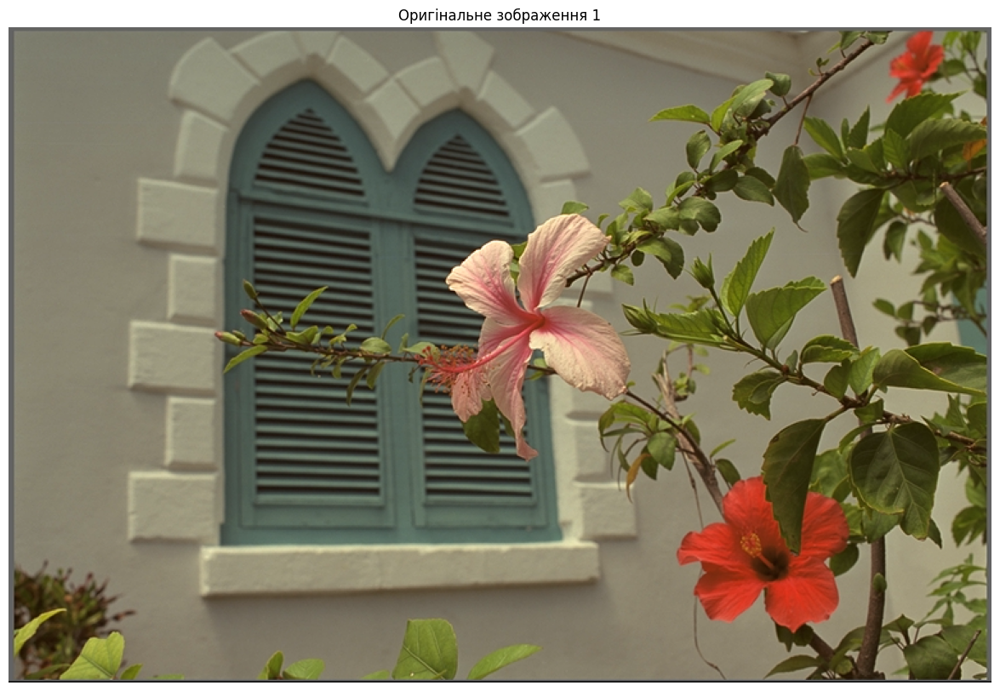

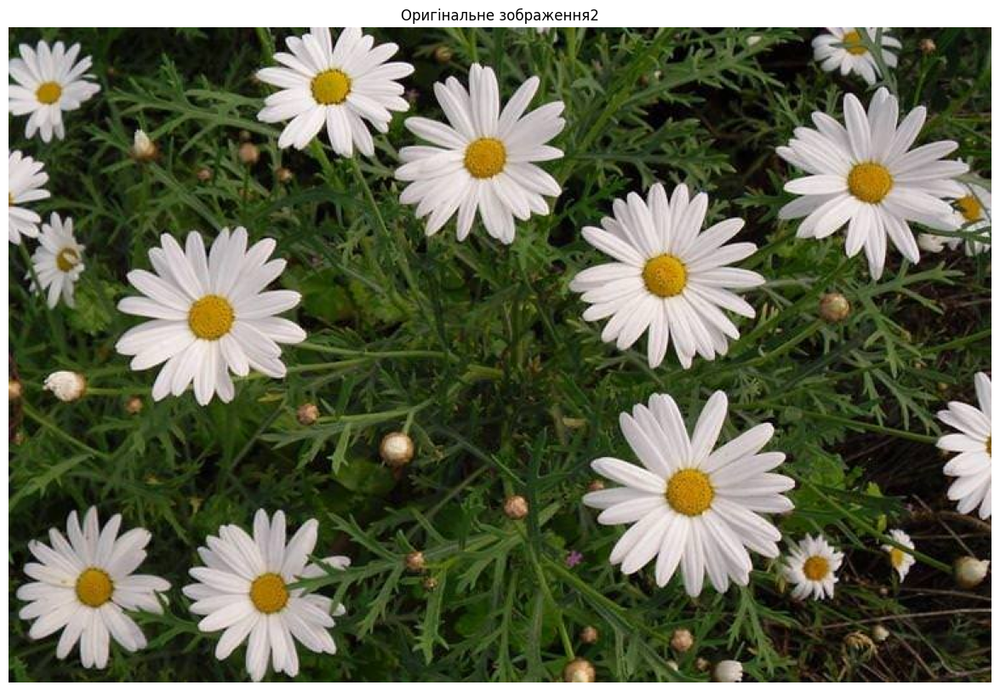

In [129]:
img1 = cv2.imread('../lab3_Verenchuk_Stanislav/data/kodim07.png')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)

img2 = cv2.imread('../lab3_Verenchuk_Stanislav/data/img4.jpg')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

plt.imshow(img1)
plt.title('Оригінальне зображення 1')
plt.axis('off')
plt.show()

plt.imshow(img2)
plt.title('Оригінальне зображення2')
plt.axis('off')
plt.show()

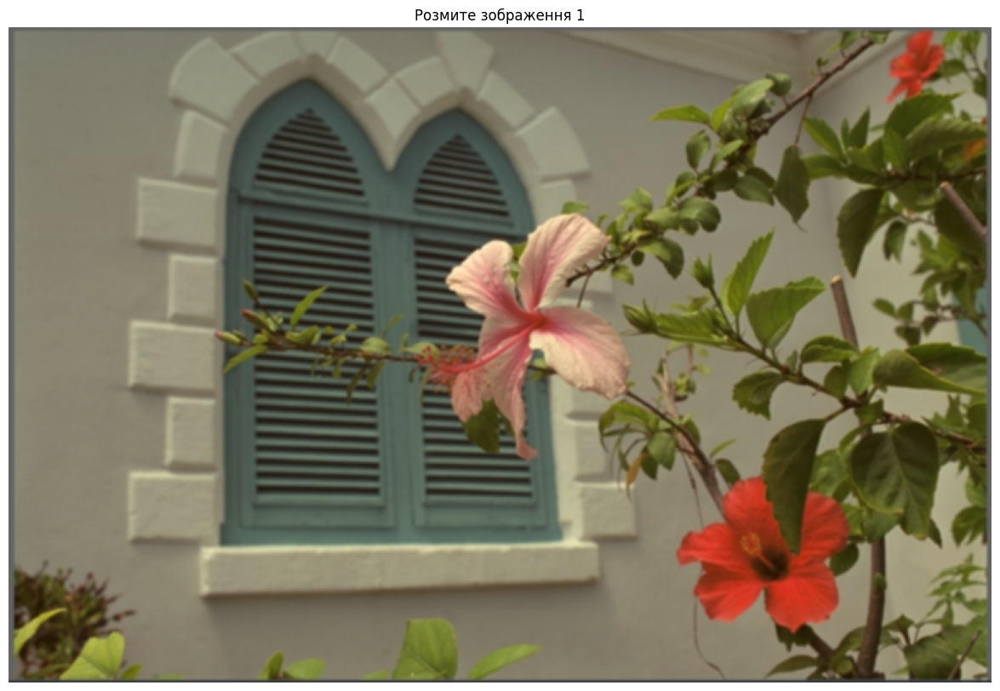

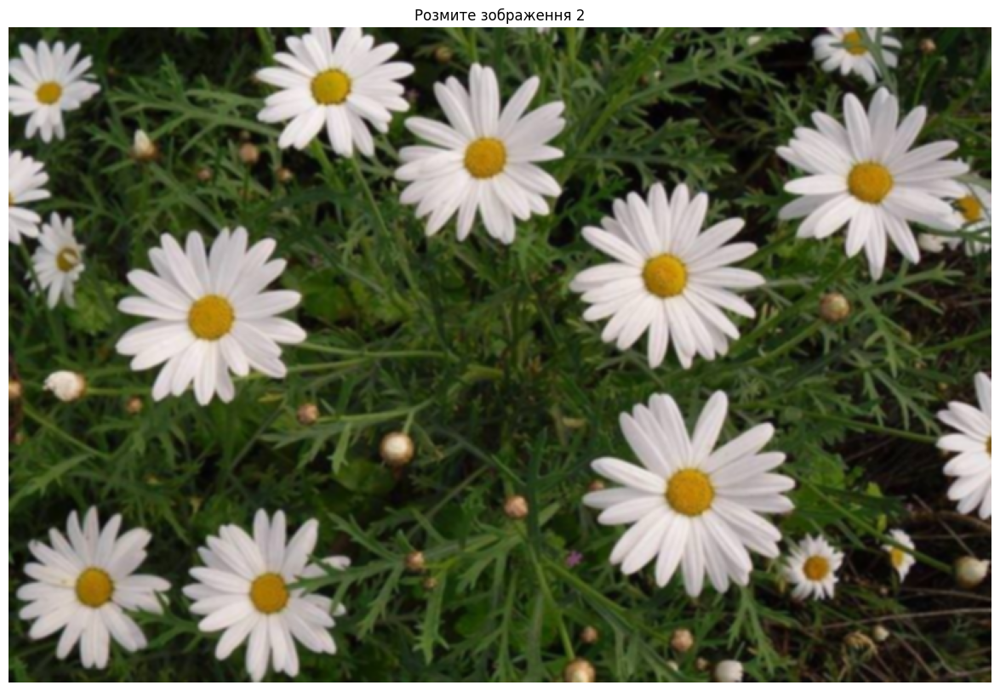

In [130]:
# Create a blurred (unsharp) version of the original image (you can use Gaussian blurring)
unsharp1 = cv2.GaussianBlur(img1, (5, 5), sigmaX=1)
unsharp2 = cv2.GaussianBlur(img2, (5, 5), sigmaX=1)

plt.imshow(unsharp1)
plt.title('Розмите зображення 1')
plt.axis('off')
plt.show()

plt.imshow(unsharp2)
plt.title('Розмите зображення 2')
plt.axis('off')
plt.show()

In [131]:
# необхідно перевести зображення в формат float, щоб не відбувалось overflow та underflow.
img_float1 = img1.astype(np.float32)
unsharp_float1 = unsharp1.astype(np.float32)

img_float2 = img2.astype(np.float32)
unsharp_float2 = unsharp2.astype(np.float32)

In [132]:
# Create the difference image (original − unsharp)
# Note: Remember that you are working with uint8 data types. Any addition or substractions
# might result in overflow or underflow, respectively. You can prevent this by casting the images to float.
diff1 = img_float1- unsharp_float1
diff2 = img_float2- unsharp_float2

In [133]:
# Apply USM to get the resulting image using `sharpened = original + (original − unsharp) × amount`
# Note: Again, take care of underflows/overflows if necessary.
amount1 = 1.0 # коефіцієнт посилення
amount2 = 1.5
amount3 = 2.0
amount4 = 3.0

sharpened11 = img_float1 + diff1 * amount1
sharpened12 = img_float1 + diff1 * amount2
sharpened13 = img_float1 + diff1 * amount3
sharpened14 = img_float1 + diff1 * amount4

sharpened11 = np.clip(sharpened11, 0, 255)
sharpened11 = sharpened11.astype(np.uint8)

sharpened12 = np.clip(sharpened12, 0, 255)
sharpened12 = sharpened12.astype(np.uint8)

sharpened13 = np.clip(sharpened13, 0, 255)
sharpened13 = sharpened13.astype(np.uint8)

sharpened14 = np.clip(sharpened14, 0, 255)
sharpened14 = sharpened14.astype(np.uint8)

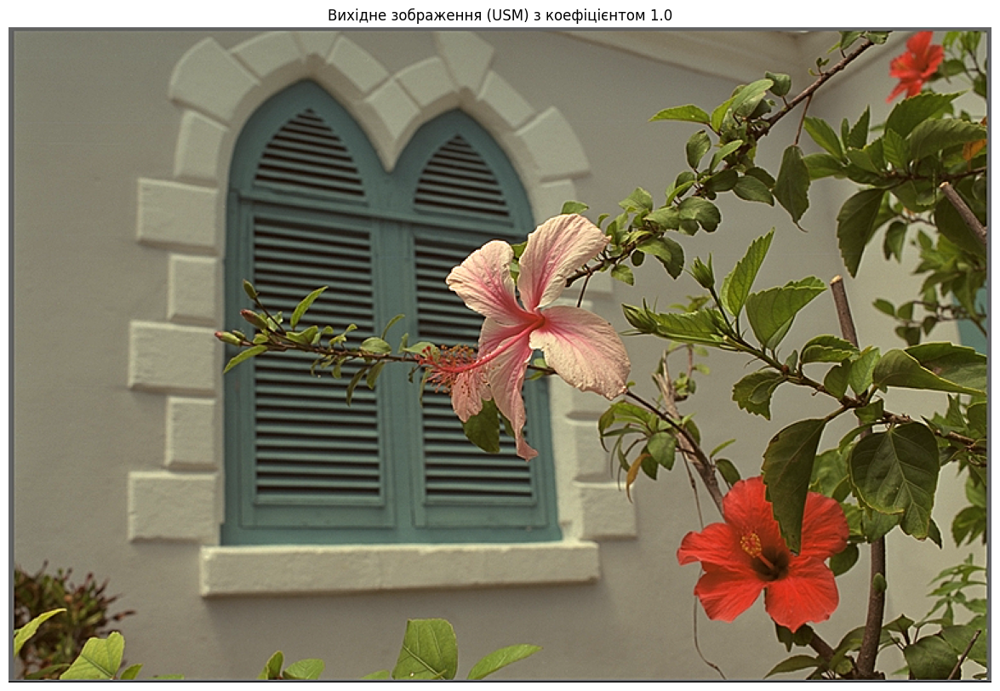

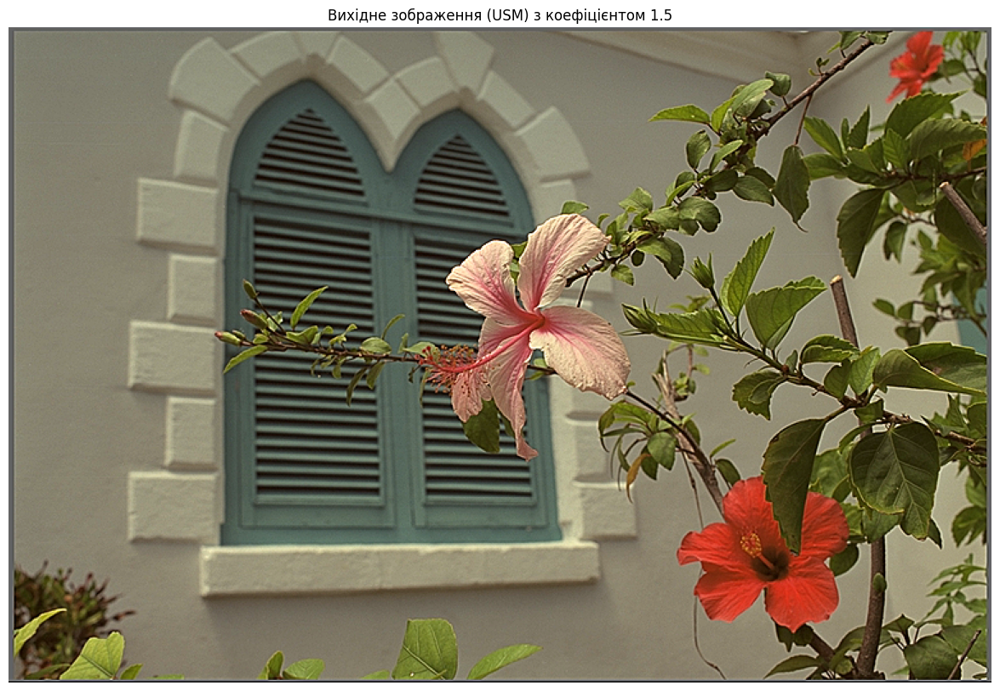

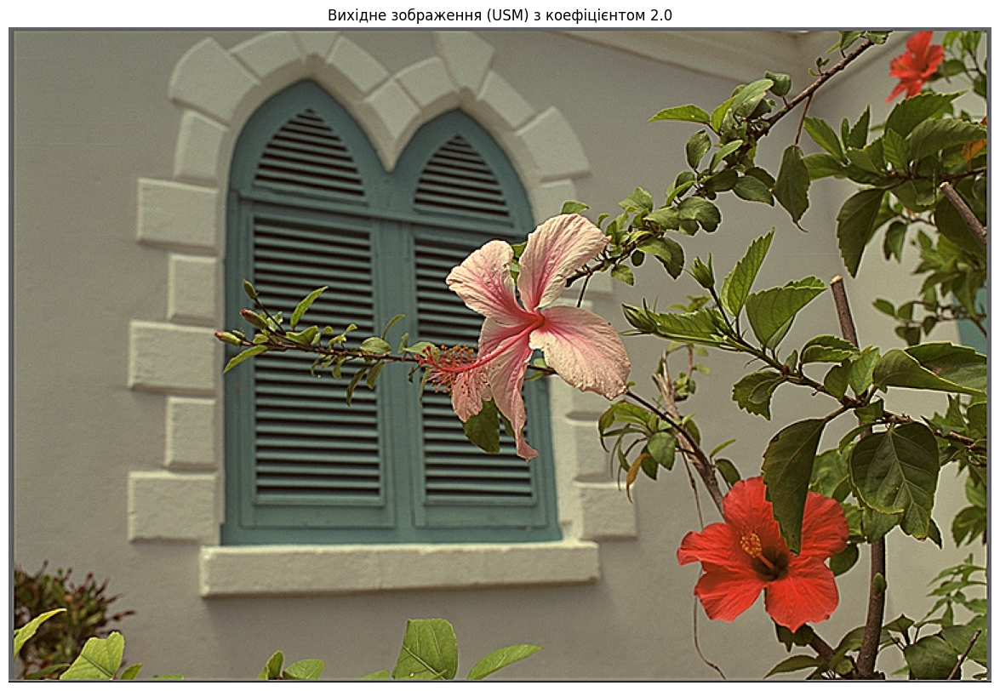

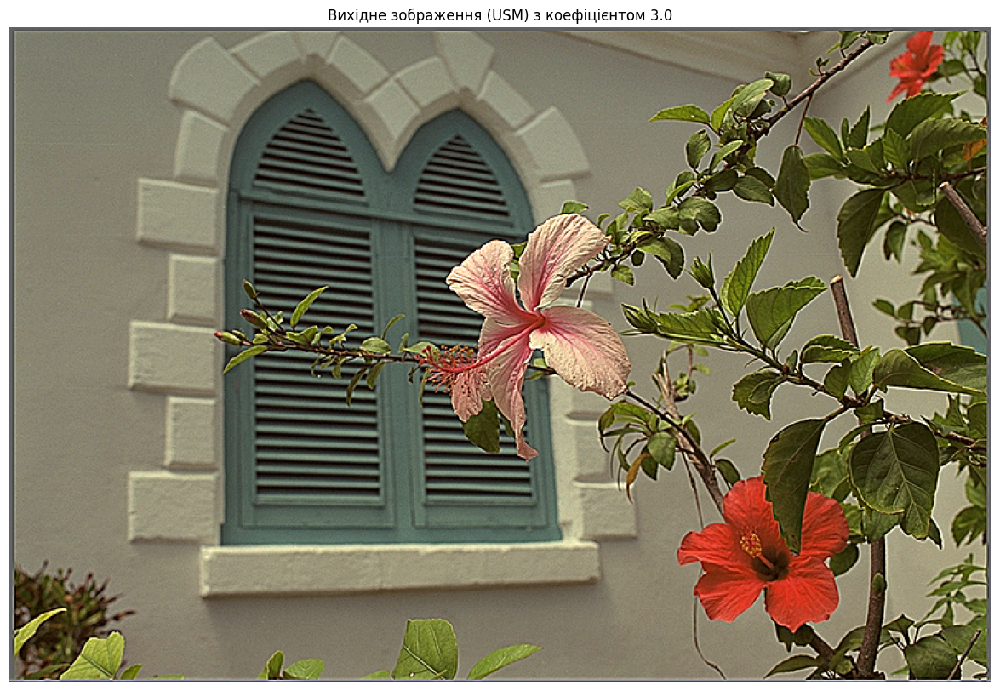

In [134]:
plt.imshow(sharpened11)
plt.title('Вихідне зображення (USM) з коефіцієнтом 1.0')
plt.axis('off')
plt.show()

plt.imshow(sharpened12)
plt.title('Вихідне зображення (USM) з коефіцієнтом 1.5')
plt.axis('off')
plt.show()

plt.imshow(sharpened13)
plt.title('Вихідне зображення (USM) з коефіцієнтом 2.0')
plt.axis('off')
plt.show()

plt.imshow(sharpened14)
plt.title('Вихідне зображення (USM) з коефіцієнтом 3.0')
plt.axis('off')
plt.show()

In [135]:
sharpened21 = img_float2 + diff2 * amount1
sharpened22 = img_float2 + diff2 * amount2
sharpened23 = img_float2 + diff2 * amount3
sharpened24 = img_float2 + diff2 * amount4

sharpened21 = np.clip(sharpened21, 0, 255)
sharpened21 = sharpened21.astype(np.uint8)

sharpened22 = np.clip(sharpened22, 0, 255)
sharpened22 = sharpened22.astype(np.uint8)

sharpened23 = np.clip(sharpened23, 0, 255)
sharpened23 = sharpened23.astype(np.uint8)

sharpened24 = np.clip(sharpened24, 0, 255)
sharpened24 = sharpened24.astype(np.uint8)

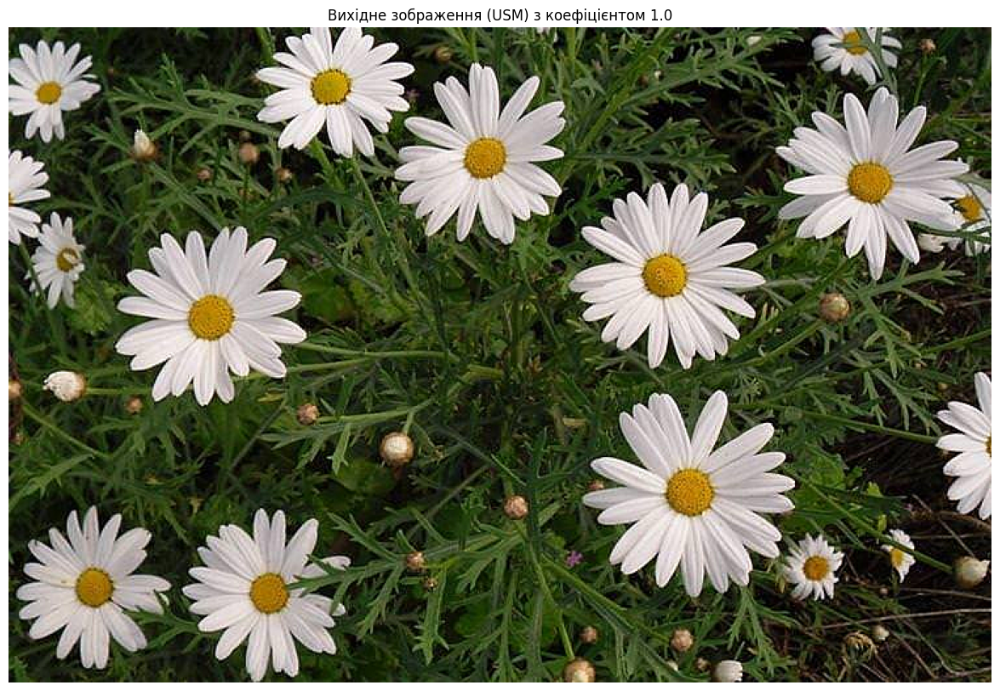

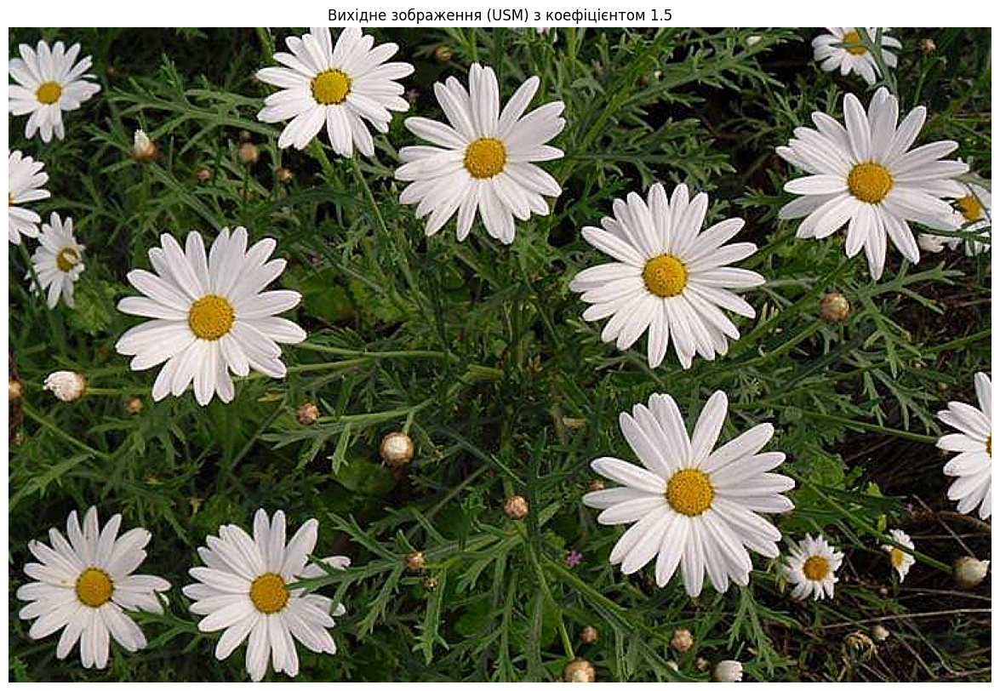

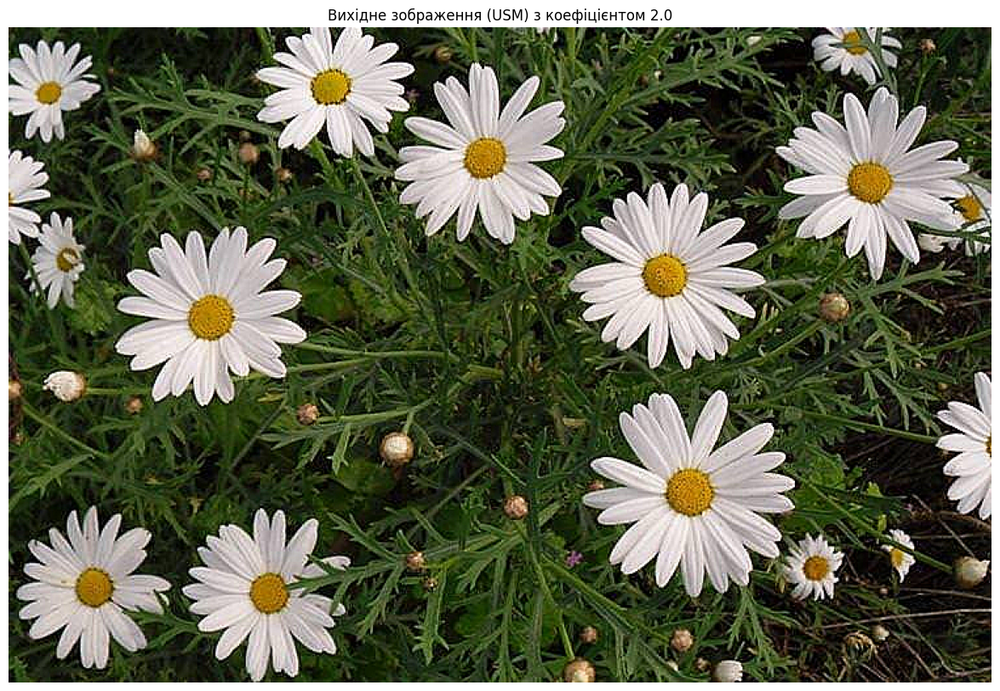

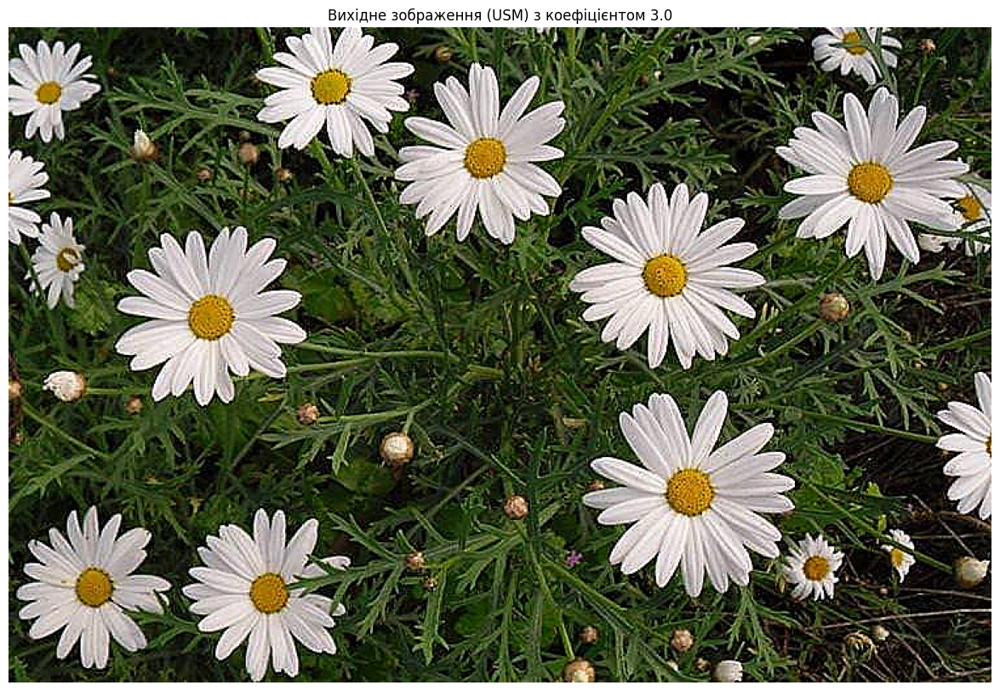

In [136]:
plt.imshow(sharpened21)
plt.title('Вихідне зображення (USM) з коефіцієнтом 1.0')
plt.axis('off')
plt.show()

plt.imshow(sharpened22)
plt.title('Вихідне зображення (USM) з коефіцієнтом 1.5')
plt.axis('off')
plt.show()

plt.imshow(sharpened23)
plt.title('Вихідне зображення (USM) з коефіцієнтом 2.0')
plt.axis('off')
plt.show()

plt.imshow(sharpened24)
plt.title('Вихідне зображення (USM) з коефіцієнтом 3.0')
plt.axis('off')
plt.show()

# Висновки
## 1. Яке оптимальне значення для параметра amount?
Оптимальні значення amount pнаходzться в межах від 1.5 до 2.0.

Зазвичай оптимальне значення amount залежить від:
- типу зображення,
- початкової різкості,
- цілей фільтрації.

## 2. Що станеться, якщо коефіцієнт занадто маленький?
- Незначне або непомітне покращення різкості.
- Контури залишаться м’якими.
- Зображення буде майже таким же, як оригінал.
- Різниця може бути помітна лише при збільшенні або в порівнянні side-by-side.

## 3. Що станеться, якщо коефіцієнт занадто великий?
- Надмірна різкість (oversharpening):
- Краї стануть неприродно "різкими".
- Колірні переходи спотворяться.
- У зображенні з'явиться надмірний шум або ефект "зернистості".

## 4. Які загальні висновки можна зробити на основі зображень та фільтрації?
Позитивні ефекти:
- Unsharp Masking ефективно покращує чіткість зображення.
- Техніка працює добре на деталізованих об'єктах: текстурах, краях, краях предметів.
- Дає контрольований рівень підсилення різкості через параметр amount.

Нюанси:
- Потрібно уважно підбирати параметри: занадто велике amount псує зображення.
- У темних/шумних зонах можливе посилення шуму.
- Важливо правильно обробляти типи даних.